<h1><center>VAE-AUTOENCODER-HIPATHIA</center></h1>

### Importaciones

Como importaciones tenemos las herramientas que necesitamos para crear las redes neuronales y llevar a cabo la experimentación.

In [1]:
##Keras y Tensorflow
import tensorflow as tf
import keras
from keras import backend as K
from keras.layers import (Input, InputLayer, Dense, Lambda, Layer, Add, Multiply, Activation)
from keras.models import Model, Sequential
from keras.utils import plot_model
from keras.callbacks import Callback
from keras import metrics,optimizers
from datetime import datetime

##Visualizaciones y tratamiento datos
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import norm
from sklearn import manifold
import pandas as pd
from matplotlib.ticker import FormatStrFormatter
from keras.utils.vis_utils import model_to_dot, plot_model
from keras.layers.normalization import BatchNormalization
from keras_tqdm import TQDMNotebookCallback
from IPython.display import SVG
import seaborn as sns
import os

Using TensorFlow backend.


### Versiones

In [2]:
print("Versión de keras: {} / Versión de tensorFlow: {} ".format(keras.__version__,tf.__version__))

Versión de keras: 2.2.4 / Versión de tensorFlow: 1.13.1 


### Cargamos los datos

Como hemos comentado tenemos observaciones con los genes mayormente expresados(5000) de 10459 tumores.

In [3]:
hipathia = pd.read_feather('GenesvsSample_counts_log2TMM_Hipathia-pathvals.feather')
print("Dataframe con los datos de hiPathia:\n\nFilas: {} \nColumnas: {}".format(hipathia.shape[0],hipathia.shape[1]))
hipathia.head(8)

Dataframe con los datos de hiPathia:

Filas: 11093 
Columnas: 1869


,P-hsa03320-37,P-hsa03320-61,P-hsa03320-46,P-hsa03320-57,P-hsa03320-64,P-hsa03320-47,P-hsa03320-65,P-hsa03320-55,P-hsa03320-56,P-hsa03320-33,...,P-hsa05321-95,P-hsa05321-122,P-hsa05321-123,P-hsa05321-55,P-hsa05321-74,P-hsa05321-81,P-hsa05321-138,P-hsa05321-75,P-hsa05321-152,sample_name
0,2.364967e-01,0.032368,0.068466,5.754841e-03,6.951022e-17,0.131454,0.118687,0.348050,0.116461,5.754841e-03,...,0.129946,0.000737,8.903472e-18,0.008088,7.308487e-19,0.000149,9.031419e-03,0.000646,0.076600,TCGA-G2-AA3B-01A-11R-A39I-07
1,7.154421e-17,0.033658,0.007176,7.154421e-17,7.154421e-17,0.113025,0.162487,0.302848,0.189650,1.265053e-02,...,0.162169,0.002530,1.062990e-03,0.019685,7.357476e-05,0.000130,9.343985e-18,0.000143,0.047016,TCGA-RW-A688-01A-11R-A35K-07
2,1.054151e-01,0.013526,0.007572,0.000000e+00,0.000000e+00,0.204740,0.183943,0.368475,0.205660,2.944895e-02,...,0.195327,0.000000,5.934947e-04,0.000000,0.000000e+00,0.000000,1.242659e-02,0.000000,0.159368,TCGA-A8-A07U-01A-11R-A034-07
3,1.210323e-02,0.046303,0.030554,8.728504e-03,4.774426e-03,0.218201,0.113565,0.332696,0.193846,4.774426e-03,...,0.228696,0.000000,1.558959e-03,0.000000,0.000000e+00,0.000000,1.215663e-02,0.000000,0.158725,TCGA-56-6546-01A-11R-1820-07
4,1.510906e-01,0.021160,0.012669,8.029669e-17,7.096158e-03,0.201647,0.143153,0.369694,0.175375,3.697334e-02,...,0.211466,0.001609,9.012507e-04,0.021110,4.209796e-05,0.000102,2.063600e-03,0.001970,0.125975,TCGA-A3-3308-01A-02R-1325-07
5,1.390816e-01,0.037990,0.014831,1.820927e-02,7.288783e-02,0.186222,0.140380,0.305799,0.196455,7.054722e-17,...,0.175735,0.006043,2.045782e-03,0.063159,4.583676e-04,0.000654,3.577988e-03,0.005634,0.088456,TCGA-80-5608-01A-31R-1949-07
6,7.209063e-02,0.072610,0.000000,0.000000e+00,8.769170e-03,0.145196,0.082114,0.243414,0.147949,0.000000e+00,...,0.200349,0.001551,8.628287e-04,0.015552,9.891346e-05,0.000178,7.305457e-04,0.001114,0.109086,TCGA-E2-A15E-06A-11R-A12D-07
7,3.925026e-02,0.025832,0.041546,6.078866e-17,5.456035e-02,0.122632,0.122417,0.283240,0.170458,1.267181e-02,...,0.193606,0.001836,1.062872e-03,0.023385,8.617809e-05,0.000330,1.086966e-02,0.001749,0.106621,TCGA-FU-A3HZ-01A-11R-A213-07


Separamos en train y en test

In [4]:
test_set_percent = 0.1
hipathia.index= hipathia['sample_name']
hipathia= hipathia.drop('sample_name',axis=1)
hipathia_test= hipathia.sample(frac=test_set_percent)
hipathia_train = hipathia
hipathia_train

,P-hsa03320-37,P-hsa03320-61,P-hsa03320-46,P-hsa03320-57,P-hsa03320-64,P-hsa03320-47,P-hsa03320-65,P-hsa03320-55,P-hsa03320-56,P-hsa03320-33,...,P-hsa05321-94,P-hsa05321-95,P-hsa05321-122,P-hsa05321-123,P-hsa05321-55,P-hsa05321-74,P-hsa05321-81,P-hsa05321-138,P-hsa05321-75,P-hsa05321-152
sample_name,,,,,,,,,,,,,,,,,,,,,
TCGA-G2-AA3B-01A-11R-A39I-07,2.364967e-01,3.236824e-02,6.846642e-02,5.754841e-03,6.951022e-17,0.131454,0.118687,0.348050,0.116461,5.754841e-03,...,8.851310e-04,0.129946,7.371300e-04,8.903472e-18,8.087661e-03,7.308487e-19,1.487161e-04,9.031419e-03,6.455259e-04,0.076600
TCGA-RW-A688-01A-11R-A35K-07,7.154421e-17,3.365827e-02,7.175542e-03,7.154421e-17,7.154421e-17,0.113025,0.162487,0.302848,0.189650,1.265053e-02,...,6.812313e-19,0.162169,2.530028e-03,1.062990e-03,1.968461e-02,7.357476e-05,1.297128e-04,9.343985e-18,1.428932e-04,0.047016
TCGA-A8-A07U-01A-11R-A034-07,1.054151e-01,1.352578e-02,7.572337e-03,0.000000e+00,0.000000e+00,0.204740,0.183943,0.368475,0.205660,2.944895e-02,...,3.120722e-04,0.195327,0.000000e+00,5.934947e-04,0.000000e+00,0.000000e+00,0.000000e+00,1.242659e-02,0.000000e+00,0.159368
TCGA-56-6546-01A-11R-1820-07,1.210323e-02,4.630333e-02,3.055438e-02,8.728504e-03,4.774426e-03,0.218201,0.113565,0.332696,0.193846,4.774426e-03,...,0.000000e+00,0.228696,0.000000e+00,1.558959e-03,0.000000e+00,0.000000e+00,0.000000e+00,1.215663e-02,0.000000e+00,0.158725
TCGA-A3-3308-01A-02R-1325-07,1.510906e-01,2.115969e-02,1.266897e-02,8.029669e-17,7.096158e-03,0.201647,0.143153,0.369694,0.175375,3.697334e-02,...,1.973857e-18,0.211466,1.609028e-03,9.012507e-04,2.110991e-02,4.209796e-05,1.023847e-04,2.063600e-03,1.970055e-03,0.125975
TCGA-80-5608-01A-31R-1949-07,1.390816e-01,3.799027e-02,1.483110e-02,1.820927e-02,7.288783e-02,0.186222,0.140380,0.305799,0.196455,7.054722e-17,...,2.775585e-18,0.175735,6.043069e-03,2.045782e-03,6.315872e-02,4.583676e-04,6.537472e-04,3.577988e-03,5.634236e-03,0.088456
TCGA-E2-A15E-06A-11R-A12D-07,7.209063e-02,7.260954e-02,0.000000e+00,0.000000e+00,8.769170e-03,0.145196,0.082114,0.243414,0.147949,0.000000e+00,...,0.000000e+00,0.200349,1.550648e-03,8.628287e-04,1.555206e-02,9.891346e-05,1.777641e-04,7.305457e-04,1.114330e-03,0.109086
TCGA-FU-A3HZ-01A-11R-A213-07,3.925026e-02,2.583158e-02,4.154606e-02,6.078866e-17,5.456035e-02,0.122632,0.122417,0.283240,0.170458,1.267181e-02,...,4.356966e-18,0.193606,1.836117e-03,1.062872e-03,2.338510e-02,8.617809e-05,3.301054e-04,1.086966e-02,1.749109e-03,0.106621
TCGA-D8-A1JM-01A-11R-A13Q-07,0.000000e+00,1.193149e-02,6.617717e-03,0.000000e+00,0.000000e+00,0.179363,0.182737,0.313075,0.236332,6.617717e-03,...,0.000000e+00,0.155934,0.000000e+00,1.315851e-03,0.000000e+00,0.000000e+00,0.000000e+00,8.642907e-03,0.000000e+00,0.076486


### Variables e hiperparámetros

In [5]:
original_dim=hipathia_train.shape[1]
latent_dim = 100

batch_size=50
epochs = 50
learning_rate=0.0005

beta = K.variable(0)
kappa = 1
epsilon_std = 1.0

Instructions for updating:
Colocations handled automatically by placer.


### Encoder

Incluyendo **batch_normalization** han encontrado que se entrena más rápido y además con una activación de caraterísticas más heterogenea, batch_normalization añade una regulación de características escalando la activación a media=0 y varianza=1.Es como un método para normalizar los inputs de cada capa. 

In [6]:
##Creamos la capa de entrada
inputs = Input(shape=(original_dim,),name='encoder_input')
##Creamos capa intermedia
x_encoder = Dense(latent_dim,kernel_initializer='glorot_uniform')(inputs)
x_encoder_log = Dense(latent_dim,kernel_initializer='glorot_uniform')(inputs)
##Creamos dos capas de salida,media y log_desviacion(se usa en lugar de la estándar)
z_mean_dense_batchnorm = BatchNormalization()(x_encoder)
log_desviacion_dense_batchnorm = BatchNormalization()(x_encoder_log)
z_mean_encoded = Activation('relu')(z_mean_dense_batchnorm)
log_desviacion = Activation('relu')(log_desviacion_dense_batchnorm)

### Decoder

In [7]:
##Creamos capa de entrada del decodificador
latent_vector = Input(shape=(latent_dim,), name='latent_vector')
outputs = Dense(original_dim,kernel_initializer='glorot_uniform',activation='sigmoid')(latent_vector)

### Sampler y CustomVariationalLayer

La función sampler es el generador del vector z y la función CustomVariationalLayer aprende y actúa sobre el entrenamiento. Se encuentra al final del modelo

In [8]:
def sampler(args):
    z_mean, z_log = args
    batch = K.shape(z_mean)[0]
    dim = K.int_shape(z_mean)[1]
    # mean and log of variance of Q(z|X)
    # we sample from the standard normal a matrix of batch_size * latent_size (taking into account minibatches)
    epsilon = K.random_normal(shape=(batch,dim))# by default, random_normal has mean=0 and std=1.0
    # sampling from Z~N(μ, σ^2) is the same as sampling from μ + σX, X~N(0,1)
    return z_mean + K.exp(0.5 * z_log) * epsilon

z = Lambda(sampler,output_shape=(latent_dim, ))([z_mean_encoded, log_desviacion])

class CustomVariationalLayer(Layer):
    """
    Define a custom layer that learns and performs the training
    This function is borrowed from:
    https://github.com/fchollet/keras/blob/master/examples/variational_autoencoder.py
    """
    def __init__(self, **kwargs):
        # https://keras.io/layers/writing-your-own-keras-layers/
        self.is_placeholder = True
        super(CustomVariationalLayer, self).__init__(**kwargs)

    def vae_loss(self, x_input, x_decoded):
        reconstruction_loss = original_dim * metrics.binary_crossentropy(x_input, x_decoded)
        kl_loss = - 0.5 * K.sum(1 + log_desviacion - K.square(z_mean_encoded) - 
                                K.exp(log_desviacion), axis=-1)
        return K.mean(reconstruction_loss + (K.get_value(beta) * kl_loss))

    def call(self, inputs):
        x = inputs[0]
        x_decoded = inputs[1]
        loss = self.vae_loss(x, x_decoded)
        self.add_loss(loss, inputs=inputs)
        # We won't actually use the output.
        return x

### WarmUpCallBack

Callback es un set de funciones que permite estudiar el entrenamiento mientras éste está en curso. Puedes llamar una lista de callback en el método fit. Estos métodos seran llamados en cada etapa del entrenamiento.

In [9]:
class WarmUpCallback(Callback):
    def __init__(self, beta, kappa):
        self.beta = beta
        self.kappa = kappa
    # Behavior on each epoch
    def on_epoch_end(self, epoch, logs={}):
        if K.get_value(self.beta) <= 1:
            K.set_value(self.beta, K.get_value(self.beta) + self.kappa)

In [10]:
np.random.seed(123)

### Compilación de modelos-VAE

El **CustomVariationalLayer()** incluye la función de pérdida VAE (reconstruction + (beta * KL)), que es lo que impulsará a nuestro modelo a aprender una representación interpretable del espacio de expresión génica.

El VAE compilado con un optimizador Adam y una función de pérdida personalizada incorporada. El parámetro loss_weights garantiza que la versión beta se actualice en cada devolución de llamada de final de época

In [11]:
##Instanciamos el optimizador
adam = optimizers.Adam(lr=learning_rate)

##Instanciamos el encoder
encoder = Model(inputs,[z_mean_encoded,log_desviacion,z],name='encoder')
print('Encoder\n')
encoder.summary()
##Instanciamos el decoder
decoder = Model(latent_vector,outputs,name='decoder')
print('Decoder\n')
decoder.summary()

outputs_final= decoder(encoder(inputs)[2])

##Creamos modelo final con la capa 'CustomVariationalLayer'
vae_layer = CustomVariationalLayer()([inputs, outputs_final])
vae = Model(inputs,vae_layer)
vae.compile(optimizer=adam, loss=None, loss_weights=[beta])
print('VAE\n')
vae.summary()

Encoder

Model: "encoder"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
encoder_input (InputLayer)      (None, 1868)         0                                            
__________________________________________________________________________________________________
dense_1 (Dense)                 (None, 100)          186900      encoder_input[0][0]              
__________________________________________________________________________________________________
dense_2 (Dense)                 (None, 100)          186900      encoder_input[0][0]              
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 100)          400         dense_1[0][0]                    
___________________________________________________________________________________

### Visualización del modelo

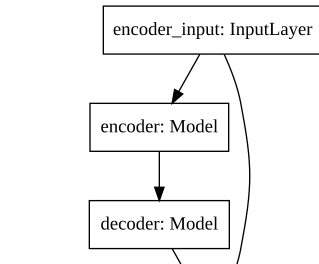

In [12]:
# Visualize the connections of the custom VAE model
plot_model(vae, to_file='modelo.png')
SVG(model_to_dot(encoder).create(prog='dot', format='svg'))
SVG(model_to_dot(decoder).create(prog='dot', format='svg'))
SVG(model_to_dot(vae).create(prog='dot', format='svg'))

### Entrenamiento

In [14]:
%%time
hist = vae.fit(np.array(hipathia_train),
               shuffle=True,
               epochs=epochs,
               verbose=0,
               batch_size=batch_size,
               validation_data=(np.array(hipathia_test), None),
               callbacks=[WarmUpCallback(beta, kappa),
                          TQDMNotebookCallback(leave_inner=True, leave_outer=True)])

Instructions for updating:
Use tf.cast instead.



Wall time: 3min 59s


### Visualización del entrenamiento

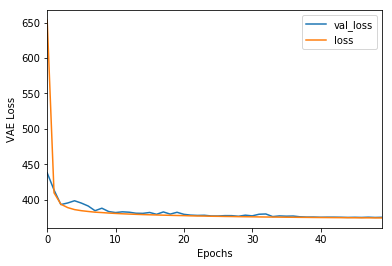

In [16]:
# Visualize training performance
history_df = pd.DataFrame(hist.history)
hist_plot_file = os.path.join('figures', 'onehidden_vae_training.pdf')
ax = history_df.plot()
ax.set_xlabel('Epochs')
ax.set_ylabel('VAE Loss')
fig = ax.get_figure()

### Estudio de modelos por separado

1.Respecto al encoder
- Poder ser utilizado para comprimir otros tumores

2.Respecto al decoder
- Modelo generativo

3.El espacio latente de todos los cánceres
- La representación reducida no linear de tumores puede ser usado como características para varias tareas.
  - Tareas de aprendizaje supervisado prediciendo inactivación de genes
  - Interpolar a través de este espacio para observar como la expresión génica cambia entre dos estados de cancer
  
4.Los pesos de los nodos para realizar la codificación
- Aprender diferencias biológicas según la activación de diferentes tumores.

### Observación de la activación de nodos

In [17]:
encoded_hipathia ,_,_ = encoder.predict_on_batch(hipathia)
encoded_hipathia = pd.DataFrame(encoded_hipathia, index=hipathia.index) ##Lo pasamos a dataframe para poder tratarlo
encoded_hipathia

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
sample_name,,,,,,,,,,,,,,,,,,,,,
TCGA-G2-AA3B-01A-11R-A39I-07,1.262327,5.041816,3.909080,6.426452,0.754932,1.969866,2.243587,-0.000000,0.894288,-0.000000,...,0.564929,2.557331,-0.000000,7.147103,0.768506,0.132509,2.893473,-0.000000,-0.000000,1.625383
TCGA-RW-A688-01A-11R-A35K-07,-0.000000,-0.000000,0.123942,4.050813,-0.000000,-0.000000,-0.000000,5.692940,-0.000000,-0.000000,...,2.537404,2.691348,2.068596,2.430562,-0.000000,1.208898,-0.000000,2.696593,-0.000000,-0.000000
TCGA-A8-A07U-01A-11R-A034-07,-0.000000,3.057817,0.688752,2.124386,0.407953,2.113467,0.956518,3.773554,-0.000000,0.715310,...,1.480008,-0.000000,1.739168,0.037575,5.672411,-0.000000,-0.000000,-0.000000,0.537454,0.763659
TCGA-56-6546-01A-11R-1820-07,-0.000000,1.006670,2.461248,3.027265,0.963448,-0.000000,0.517056,3.086637,4.416391,2.051925,...,0.516842,-0.000000,-0.000000,-0.000000,0.119345,2.201745,1.391819,0.804861,1.705106,1.652456
TCGA-A3-3308-01A-02R-1325-07,-0.000000,-0.000000,-0.000000,2.278746,-0.000000,0.446275,0.390345,-0.000000,-0.000000,0.720982,...,-0.000000,2.097759,1.238468,4.040083,1.169938,2.566679,-0.000000,-0.000000,4.327602,3.951174
TCGA-80-5608-01A-31R-1949-07,-0.000000,2.508181,1.087620,-0.000000,-0.000000,-0.000000,2.479312,4.657386,0.390525,-0.000000,...,1.910404,-0.000000,2.683223,1.142705,2.534388,3.389588,0.015367,3.398422,2.246954,2.704761
TCGA-E2-A15E-06A-11R-A12D-07,4.266719,0.956427,4.950879,0.186004,-0.000000,-0.000000,-0.000000,1.071441,0.127386,2.142935,...,3.380437,-0.000000,0.628494,-0.000000,0.816079,2.446541,1.042344,1.214645,0.146238,-0.000000
TCGA-FU-A3HZ-01A-11R-A213-07,0.868087,1.267778,2.299326,4.767134,2.097321,1.190327,0.841585,1.971219,1.565516,-0.000000,...,2.518566,0.275014,0.716324,0.479280,-0.000000,1.808198,0.939936,0.135635,-0.000000,0.520020
TCGA-D8-A1JM-01A-11R-A13Q-07,1.357108,0.513624,-0.000000,0.147273,2.226822,-0.000000,1.702127,4.463172,-0.000000,-0.000000,...,0.472760,-0.000000,-0.000000,3.026288,5.610915,-0.000000,1.579622,0.600967,2.584968,1.818946


In [18]:
# What are the most and least activated nodes
sum_node_activity = encoded_hipathia.sum(axis=0).sort_values(ascending=False)

# Top 10 most active nodes
print(sum_node_activity.head(10))

# Bottom 10 least active nodes
sum_node_activity.tail(10)

72    29977.699219
60    26735.742188
67    25890.619141
55    23987.984375
70    23171.437500
35    23083.240234
81    23022.841797
71    22830.410156
25    22640.929688
59    22511.250000
dtype: float32


45    11303.971680
5     11257.774414
24    11009.606445
53    10972.959961
6     10827.115234
9     10661.067383
50     9658.781250
66     9409.726562
62     9166.519531
4      8672.930664
dtype: float32

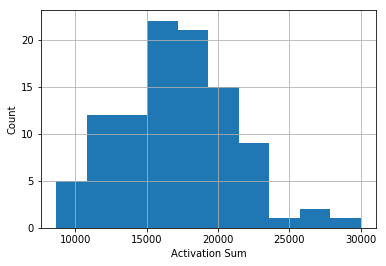

In [19]:
# Histogram of node activity for all 100 latent features
sum_node_activity.hist()
plt.xlabel('Activation Sum')
plt.ylabel('Count');

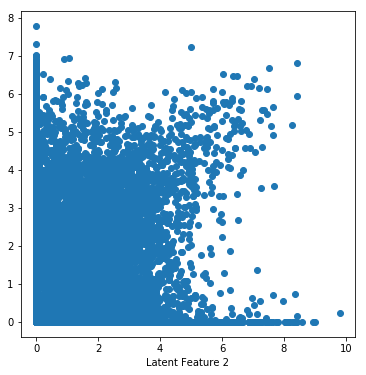

In [20]:
# Example of node activation distribution for the first two latent features
plt.figure(figsize=(6, 6))
plt.scatter(encoded_hipathia.iloc[:, 1], encoded_hipathia.iloc[:, 2])
plt.xlabel('Latent Feature 1')
plt.xlabel('Latent Feature 2');

In [21]:
# How well does the model reconstruct the input Hipathia data
input_hipathia_reconstruct = decoder.predict(np.array(encoded_hipathia))
input_hipathia_reconstruct = pd.DataFrame(input_hipathia_reconstruct, index=hipathia.index,
                                        columns=hipathia.columns)
input_hipathia_reconstruct.head(2)

,P-hsa03320-37,P-hsa03320-61,P-hsa03320-46,P-hsa03320-57,P-hsa03320-64,P-hsa03320-47,P-hsa03320-65,P-hsa03320-55,P-hsa03320-56,P-hsa03320-33,...,P-hsa05321-94,P-hsa05321-95,P-hsa05321-122,P-hsa05321-123,P-hsa05321-55,P-hsa05321-74,P-hsa05321-81,P-hsa05321-138,P-hsa05321-75,P-hsa05321-152
sample_name,,,,,,,,,,,,,,,,,,,,,
TCGA-G2-AA3B-01A-11R-A39I-07,0.189474,0.062324,0.056851,0.026190,0.012720,0.157546,0.131275,0.372489,0.160823,0.010821,...,0.00018,0.171179,0.001853,0.00158,0.021061,0.000237,0.000369,0.005571,0.001563,0.108381
TCGA-RW-A688-01A-11R-A35K-07,0.015965,0.050551,0.013942,0.006517,0.007413,0.135551,0.142519,0.288241,0.179613,0.013000,...,0.00001,0.174686,0.003030,0.00198,0.025191,0.000123,0.000127,0.000595,0.000613,0.068219


In [22]:
reconstruction_fidelity = hipathia - input_hipathia_reconstruct

hipathia_mean = reconstruction_fidelity.mean(axis=0)
hipathia_abssum = reconstruction_fidelity.abs().sum(axis=0).divide(hipathia.shape[0])
hipathia_summary = pd.DataFrame([hipathia_mean, hipathia_abssum], index=['hipathia mean', 'hipathia abs(sum)']).T
hipathia_summary.sort_values(by='hipathia abs(sum)', ascending=False).head()

,hipathia mean,hipathia abs(sum)
P-hsa04750-62,-0.031890,0.048306
P-hsa04970-45,-0.022862,0.044579
P-hsa05032-30,-0.020972,0.044450
P-hsa04930-7,0.006271,0.043703
P-hsa04970-39,-0.012735,0.042284


### Tratamiento del index previo a las visualizaciones

In [23]:
whole_hipathia= pd.read_feather('wholeTCGA_clinicaldata_curated.feather')
tumor_tissue = set(whole_hipathia['tumor_tissue_site'])
tumor_tissue = list(tumor_tissue)
whole_hipathia.index = whole_hipathia['bcr_patient_barcode']

Tenemos que cambiar índices para poder hacer el match con el de hipathia

In [24]:
indice_tsn = list(encoded_hipathia.index)
indice_tsn = [x[:12] for x in indice_tsn]
indice_tsn

['TCGA-G2-AA3B',
 'TCGA-RW-A688',
 'TCGA-A8-A07U',
 'TCGA-56-6546',
 'TCGA-A3-3308',
 'TCGA-80-5608',
 'TCGA-E2-A15E',
 'TCGA-FU-A3HZ',
 'TCGA-D8-A1JM',
 'TCGA-AN-A0AT',
 'TCGA-AB-2876',
 'TCGA-EW-A3E8',
 'TCGA-CV-6950',
 'TCGA-AG-3609',
 'TCGA-DR-A0ZM',
 'TCGA-JY-A93E',
 'TCGA-12-5299',
 'TCGA-A8-A085',
 'TCGA-S9-A6U8',
 'TCGA-IR-A3LB',
 'TCGA-DG-A2KJ',
 'TCGA-BG-A186',
 'TCGA-64-1679',
 'TCGA-CZ-5989',
 'TCGA-OE-A75W',
 'TCGA-85-A50Z',
 'TCGA-AA-3979',
 'TCGA-CV-7183',
 'TCGA-AO-A1KQ',
 'TCGA-BH-A0E0',
 'TCGA-13-1507',
 'TCGA-D8-A1JS',
 'TCGA-QR-A6GR',
 'TCGA-S7-A7WQ',
 'TCGA-NF-A4WU',
 'TCGA-A4-8312',
 'TCGA-44-6145',
 'TCGA-B5-A5OC',
 'TCGA-06-0156',
 'TCGA-E2-A2P5',
 'TCGA-G3-A3CI',
 'TCGA-AX-A2IN',
 'TCGA-CJ-5672',
 'TCGA-44-2656',
 'TCGA-AB-2952',
 'TCGA-ZG-A9LU',
 'TCGA-UY-A9PB',
 'TCGA-SR-A6MX',
 'TCGA-BJ-A2N8',
 'TCGA-EM-A2P1',
 'TCGA-HC-8260',
 'TCGA-P5-A72W',
 'TCGA-KC-A7F3',
 'TCGA-CQ-5330',
 'TCGA-X6-A8C5',
 'TCGA-DJ-A3V7',
 'TCGA-EJ-7325',
 'TCGA-FD-A3SN',
 'TCGA-D8-A1J9

### T_SNE

In [25]:
def tiempo():
    instanteInicial = datetime.now()
    instanteFinal = datetime.now()
    tiempo = instanteFinal - instanteInicial
    return tiempo

In [26]:
instanteInicial = datetime.now()
tsne = manifold.TSNE(n_components=2, init='pca', random_state=0, perplexity=20,
                     learning_rate=300, n_iter=400)
tsne_out = tsne.fit_transform(encoded_hipathia)
tsne_out = pd.DataFrame(tsne_out, columns=['1', '2'])
tsne_out.index = indice_tsn
tsne_out.index.name = 'tcga_id'
tsne_out_file = os.path.join('results', 'tybalt_tsne_features_hipathia.tsv')
tsne_out.to_csv(tsne_out_file, sep='\t')
tsne_out.head(2)
instanteFinal = datetime.now()
tiempo = instanteFinal - instanteInicial
print(tiempo)

0:02:15.365023


In [27]:
tsne_vae=tsne_out
whole_hipathia_tissue = whole_hipathia['tumor_tissue_site']
palette_order = tumor_tissue
tsne_vae_df = pd.merge(tsne_vae, whole_hipathia, left_index=True, right_index=True, how='left')
tsne_vae_df

,1,2,bcr_patient_barcode,additional_studies,tumor_tissue_site,histological_type,other_dx,gender,vital_status,days_to_birth,...,V536,V538,V542,V545,V546,V547,V553,V554,V561,V573
TCGA-02-0047,25.514616,0.469798,TCGA-02-0047,None,Brain,Untreated primary (de novo) GBM,None,MALE,Dead,-28759,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-0055,21.582689,2.955123,TCGA-02-0055,None,Brain,Untreated primary (de novo) GBM,None,FEMALE,Dead,-22798,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2483,22.842365,-1.666481,TCGA-02-2483,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-15964,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2485,23.222223,-0.979798,TCGA-02-2485,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-19494,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2486,20.536058,1.544632,TCGA-02-2486,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-23394,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1331,5.929803,19.185133,TCGA-04-1331,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-28848,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1332,6.463063,19.936623,TCGA-04-1332,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-25786,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1338,4.405243,19.609314,TCGA-04-1338,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Alive,-28789,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1341,3.244575,15.301659,TCGA-04-1341,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Alive,-31215,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1343,3.684985,21.165159,TCGA-04-1343,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-26428,...,None,None,None,None,None,None,None,None,None,None


Text(0.5, 1.0, 't-SNE ENCODED')

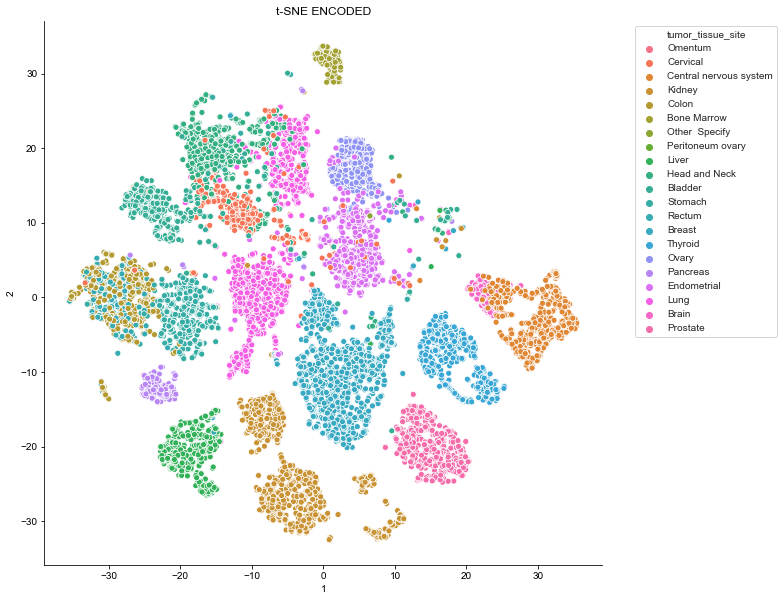

In [28]:
f, ax = plt.subplots(figsize=(10, 10))
sns.set_style("whitegrid")
sns.despine(f, right=True, top=True)  
sns.scatterplot(x="1", y="2",hue="tumor_tissue_site",hue_order=palette_order,data=tsne_vae_df,ax=ax)
plt.legend(bbox_to_anchor=(1.05, 1), loc='best')
plt.title("t-SNE ENCODED")

### TSNE-NORMALIZATION

In [29]:
def tiempo():
    instanteInicial = datetime.now()
    instanteFinal = datetime.now()
    tiempo = instanteFinal - instanteInicial
    return tiempo

In [30]:
instanteInicial = datetime.now()
tsne_n = manifold.TSNE(n_components=2, init='pca', random_state=0, perplexity=20,
                     learning_rate=300, n_iter=400)
tsne_out_n = tsne.fit_transform(encoded_hipathia)
tsne_out_n = pd.DataFrame(tsne_out_n, columns=['1', '2'])
tsne_out_n.index = indice_tsn
tsne_out_n.index.name = 'tcga_id'
tsne_out_file_n = os.path.join('results', 'tybalt_tsne_features_hn.tsv')
tsne_out_n.to_csv(tsne_out_file_n, sep='\t')
tsne_out_n.head(2)
instanteFinal = datetime.now()
tiempo = instanteFinal - instanteInicial
print(tiempo)

0:02:18.473393


In [31]:
tsne_vae_n=tsne_out_n
whole_hipathia_tissue = whole_hipathia['tumor_tissue_site']
palette_order = tumor_tissue
tsne_vae_hn = pd.merge(tsne_vae_n, whole_hipathia, right_index=True,left_index=True)
tsne_vae_hn

,1,2,bcr_patient_barcode,additional_studies,tumor_tissue_site,histological_type,other_dx,gender,vital_status,days_to_birth,...,V536,V538,V542,V545,V546,V547,V553,V554,V561,V573
TCGA-02-0047,25.514616,0.469798,TCGA-02-0047,None,Brain,Untreated primary (de novo) GBM,None,MALE,Dead,-28759,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-0055,21.582689,2.955123,TCGA-02-0055,None,Brain,Untreated primary (de novo) GBM,None,FEMALE,Dead,-22798,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2483,22.842365,-1.666481,TCGA-02-2483,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-15964,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2485,23.222223,-0.979798,TCGA-02-2485,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-19494,...,None,None,None,None,None,None,None,None,None,None
TCGA-02-2486,20.536058,1.544632,TCGA-02-2486,None,Brain,Untreated primary (de novo) GBM,None,MALE,Alive,-23394,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1331,5.929803,19.185133,TCGA-04-1331,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-28848,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1332,6.463063,19.936623,TCGA-04-1332,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-25786,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1338,4.405243,19.609314,TCGA-04-1338,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Alive,-28789,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1341,3.244575,15.301659,TCGA-04-1341,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Alive,-31215,...,None,None,None,None,None,None,None,None,None,None
TCGA-04-1343,3.684985,21.165159,TCGA-04-1343,None,Ovary,Serous Cystadenocarcinoma,None,FEMALE,Dead,-26428,...,None,None,None,None,None,None,None,None,None,None


Text(0.5, 1.0, 't-SNE 0-1')

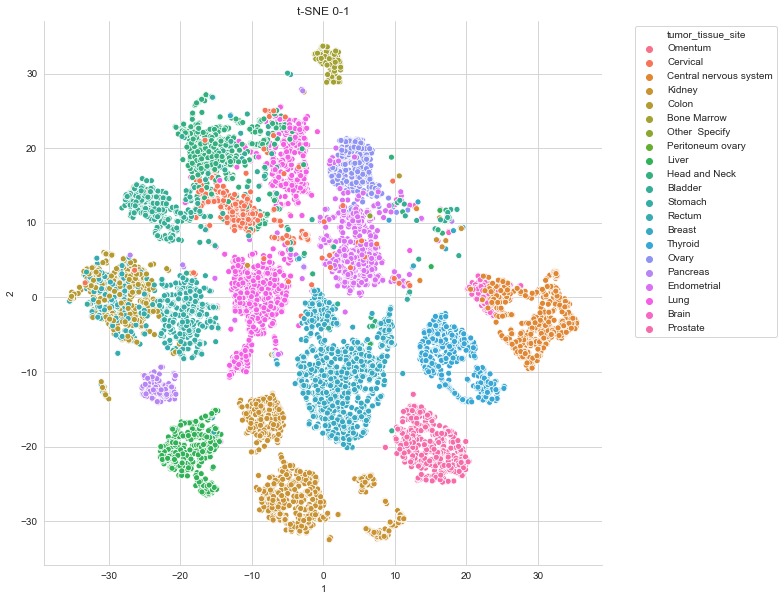

In [32]:
f, ax = plt.subplots(figsize=(10, 10))
sns.set_style("whitegrid")
sns.despine(f, right=True, top=True)  
sns.scatterplot(x="1", y="2",hue="tumor_tissue_site",hue_order=palette_order,data=tsne_vae_hn,ax=ax)
plt.legend(bbox_to_anchor=(1.05, 1), loc='best')
plt.title("t-SNE 0-1")

## Heatmap

Text(0.5, 1.0, 'Heatmap')

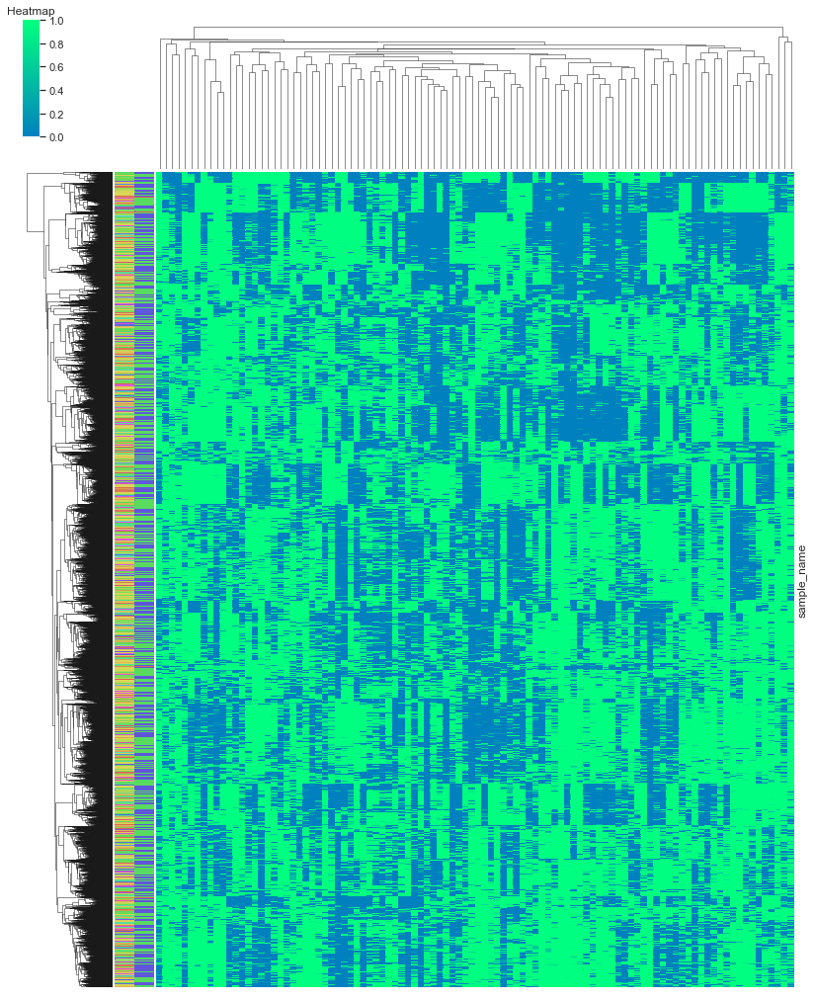

In [33]:
### Seleccionamos las 100 características el ejemplo
clinical_sample= encoded_hipathia
sample_type_vector = tsne_vae_df['histological_type']
sexo = tsne_vae_df['gender']

lut1 = dict(zip(sample_type_vector.unique(), sns.hls_palette(len(sample_type_vector.unique()))))
row_colors1 = sample_type_vector.map(lut1)

#Create additional row_colors here
lut2 = dict(zip(set(sexo), sns.hls_palette(len(set(sexo)))))
row_colors2 = sexo.map(lut2)

sns.set()
sns.clustermap(clinical_sample, center=0, cmap='winter', row_colors=[row_colors1, row_colors2],xticklabels=False,yticklabels=False,linewidths=0, figsize=(14, 18),vmin=0,vmax=1)
plt.title('Heatmap')

### Que nodo representa mejor el sexo

In [36]:
encoded_hipathia_sex = encoded_hipathia
encoded_hipathia.index= indice_tsn
whole_hipathia_gender = whole_hipathia['gender']
encoded_sex = pd.merge(encoded_hipathia, whole_hipathia_gender, right_index=True,left_index=True)

In [37]:
# Extract the weights from the decoder model
weights = []
for layer in decoder.layers:
    weights.append(layer.get_weights())
    
weight_layer_df = pd.DataFrame(weights[1][0], columns=hipathia_train.columns, index=range(1, 101))
weight_layer_df.index.name = 'encodings'
weight_layer_df

,P-hsa03320-37,P-hsa03320-61,P-hsa03320-46,P-hsa03320-57,P-hsa03320-64,P-hsa03320-47,P-hsa03320-65,P-hsa03320-55,P-hsa03320-56,P-hsa03320-33,...,P-hsa05321-94,P-hsa05321-95,P-hsa05321-122,P-hsa05321-123,P-hsa05321-55,P-hsa05321-74,P-hsa05321-81,P-hsa05321-138,P-hsa05321-75,P-hsa05321-152
encodings,,,,,,,,,,,,,,,,,,,,,
1,-0.001568,-0.019510,-0.044502,-0.056797,-0.054299,-0.003687,-0.015276,-0.021915,-0.007974,-0.062860,...,-0.027974,0.004282,-0.002039,-0.024386,0.006030,-0.014282,0.003182,-0.060591,0.001305,-0.002975
2,-0.021350,-0.023949,-0.040020,-0.013973,-0.044679,-0.002966,-0.010792,-0.006632,-0.009227,-0.024332,...,-0.070645,0.000889,-0.054982,-0.048071,-0.032514,-0.069681,-0.059101,-0.030299,-0.031547,-0.003742
3,0.027396,-0.001752,0.005072,0.022376,-0.000572,-0.007096,-0.013214,0.003631,-0.009420,-0.018014,...,-0.099995,-0.002034,-0.023997,-0.040620,-0.010216,-0.033729,-0.047885,-0.043529,-0.033264,-0.008510
4,0.003063,0.017228,0.039399,0.043933,0.004627,-0.003665,0.010824,0.005624,0.011233,0.015297,...,-0.031630,-0.006102,-0.069715,-0.007778,-0.044926,-0.036413,-0.053808,-0.003322,-0.059695,0.001815
5,-0.013694,-0.048483,-0.084071,-0.097075,-0.059860,-0.003722,0.000017,0.010984,-0.007728,-0.007740,...,-0.049041,-0.001595,-0.045272,-0.056643,-0.025532,-0.069359,-0.061912,-0.015941,-0.043651,-0.010043
6,0.032074,-0.042039,0.001942,-0.025610,-0.019133,0.001015,-0.003637,0.009589,-0.003180,-0.028705,...,-0.092720,-0.004272,-0.066524,-0.025495,-0.057109,-0.087615,-0.114732,-0.067433,-0.059434,-0.022486
7,-0.003053,-0.051152,-0.041836,-0.052136,-0.017669,-0.015668,0.005340,0.000155,-0.002697,-0.050424,...,-0.055369,-0.006869,-0.059805,-0.023164,-0.045669,-0.051960,-0.077343,-0.023870,-0.075260,-0.012359
8,-0.059229,-0.047180,-0.043932,-0.076901,-0.060143,-0.009905,-0.001272,-0.008068,-0.002355,-0.048934,...,-0.065607,0.001594,-0.037437,-0.057489,-0.013383,-0.028388,-0.029379,-0.014790,-0.011049,-0.001758
9,-0.003679,0.019336,0.012462,0.009895,0.015973,-0.001791,-0.012110,-0.002159,-0.008081,-0.017787,...,-0.038365,-0.000279,-0.064843,-0.046499,-0.038200,-0.082857,-0.060734,-0.026388,-0.047515,-0.008206


## Vamos a estudiar los nodos de 10 en 10

### 0-10

In [38]:
encoded_hipathia_sex = encoded_hipathia
encoded_hipathia.index= indice_tsn
whole_hipathia_gender = whole_hipathia['gender']
encoded_sex_10 = pd.merge(encoded_hipathia.iloc[:,:10], whole_hipathia_gender, right_index=True,left_index=True)
encoded_sex_10

,0,1,2,3,4,5,6,7,8,9,gender
TCGA-02-0047,0.519725,1.226738,-0.000000,3.761378,-0.000000,4.610021,-0.000000,-0.000000,2.640134,3.041801,MALE
TCGA-02-0055,1.075561,1.171737,-0.000000,1.803114,-0.000000,5.101211,-0.000000,1.315566,4.839661,2.952394,FEMALE
TCGA-02-2483,1.070807,0.157808,-0.000000,0.983341,-0.000000,5.533022,-0.000000,0.458252,5.371752,1.437718,MALE
TCGA-02-2485,1.286136,-0.000000,-0.000000,0.809569,-0.000000,3.485251,0.338072,-0.000000,3.946434,3.868932,MALE
TCGA-02-2486,1.242717,2.819190,-0.000000,0.016479,-0.000000,4.643353,-0.000000,-0.000000,3.573849,5.513324,MALE
TCGA-04-1331,2.030092,0.964768,0.896913,0.320254,1.290970,-0.000000,-0.000000,0.666565,-0.000000,0.788300,FEMALE
TCGA-04-1332,1.821472,1.502212,0.099801,1.286961,1.477340,-0.000000,-0.000000,-0.000000,3.454430,-0.000000,FEMALE
TCGA-04-1338,2.590911,2.514381,0.877000,4.005891,1.182555,0.653726,0.752225,2.122078,3.593451,-0.000000,FEMALE
TCGA-04-1341,2.118676,3.472436,-0.000000,-0.000000,1.761804,0.252653,-0.000000,1.176267,-0.000000,-0.000000,FEMALE
TCGA-04-1343,0.869185,2.020051,-0.000000,-0.000000,1.274955,-0.000000,-0.000000,0.601524,0.086351,-0.000000,FEMALE


C:\Users\angel\Anaconda3\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


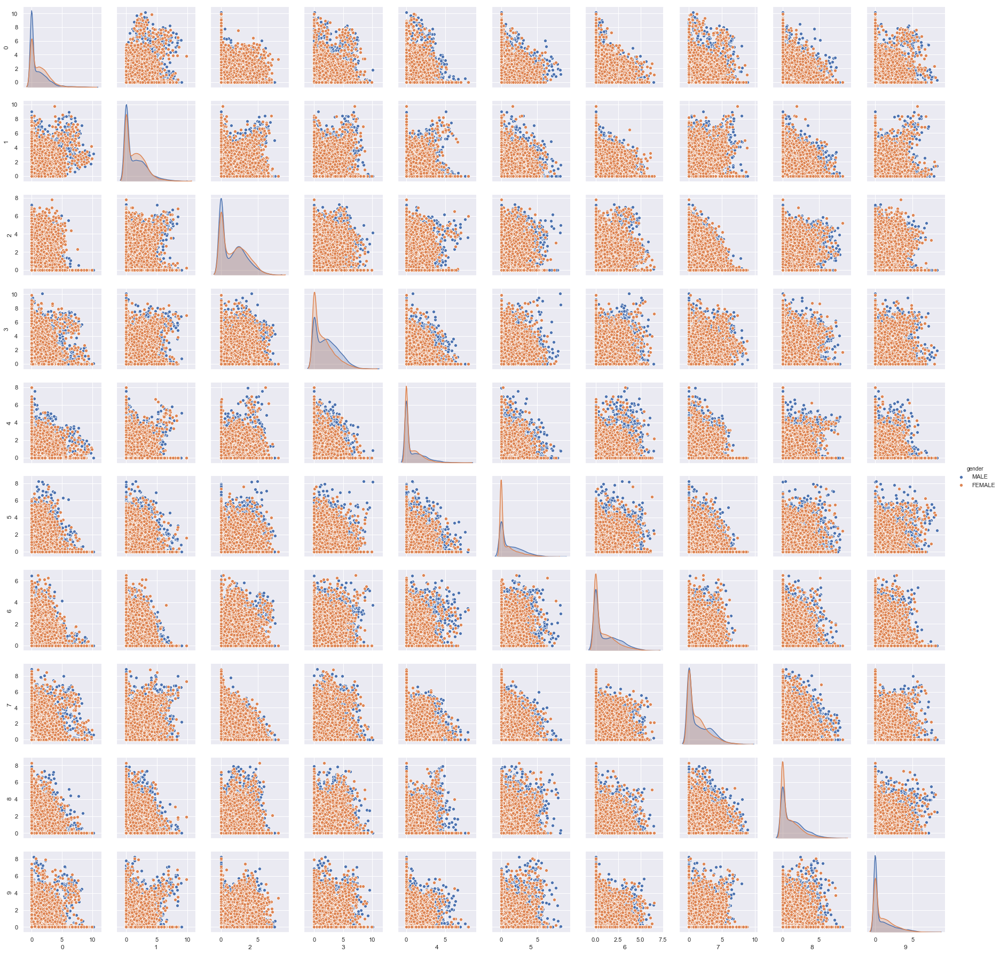

In [39]:
sns.pairplot(encoded_sex_10, hue="gender")

### 10-20

In [40]:
encoded_sex_20 = pd.merge(encoded_hipathia.iloc[:,10:20], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_20

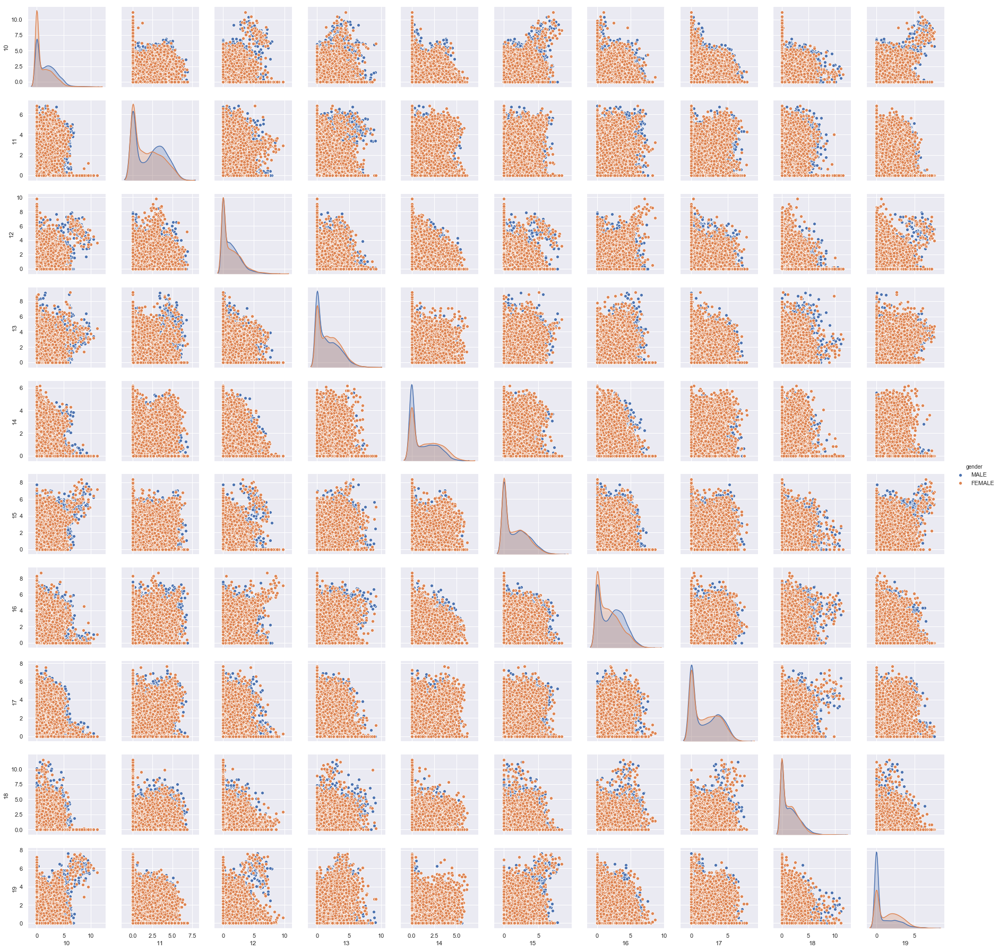

In [41]:
sns.pairplot(encoded_sex_20, hue="gender")

### 20-30

In [42]:
encoded_sex_30 = pd.merge(encoded_hipathia.iloc[:,20:30], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_30

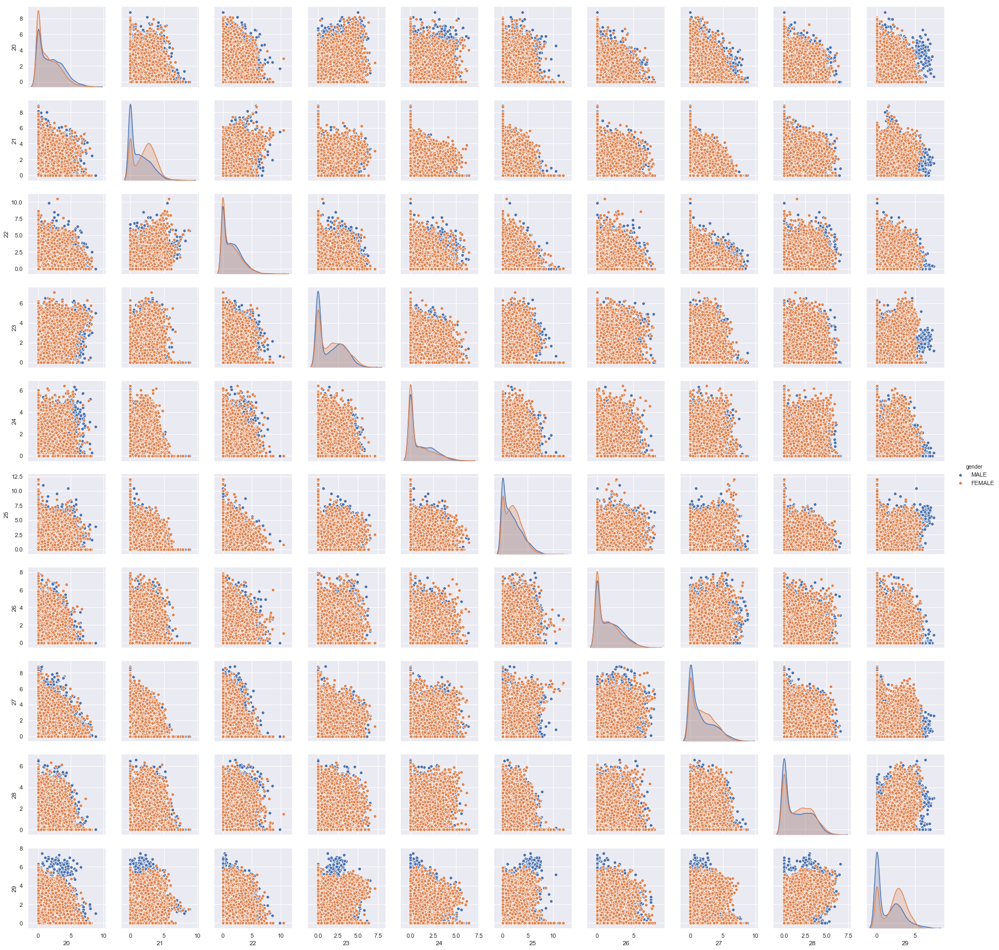

In [43]:
sns.pairplot(encoded_sex_30, hue="gender")

### 30-40

In [44]:
encoded_sex_40 = pd.merge(encoded_hipathia.iloc[:,30:40], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_40

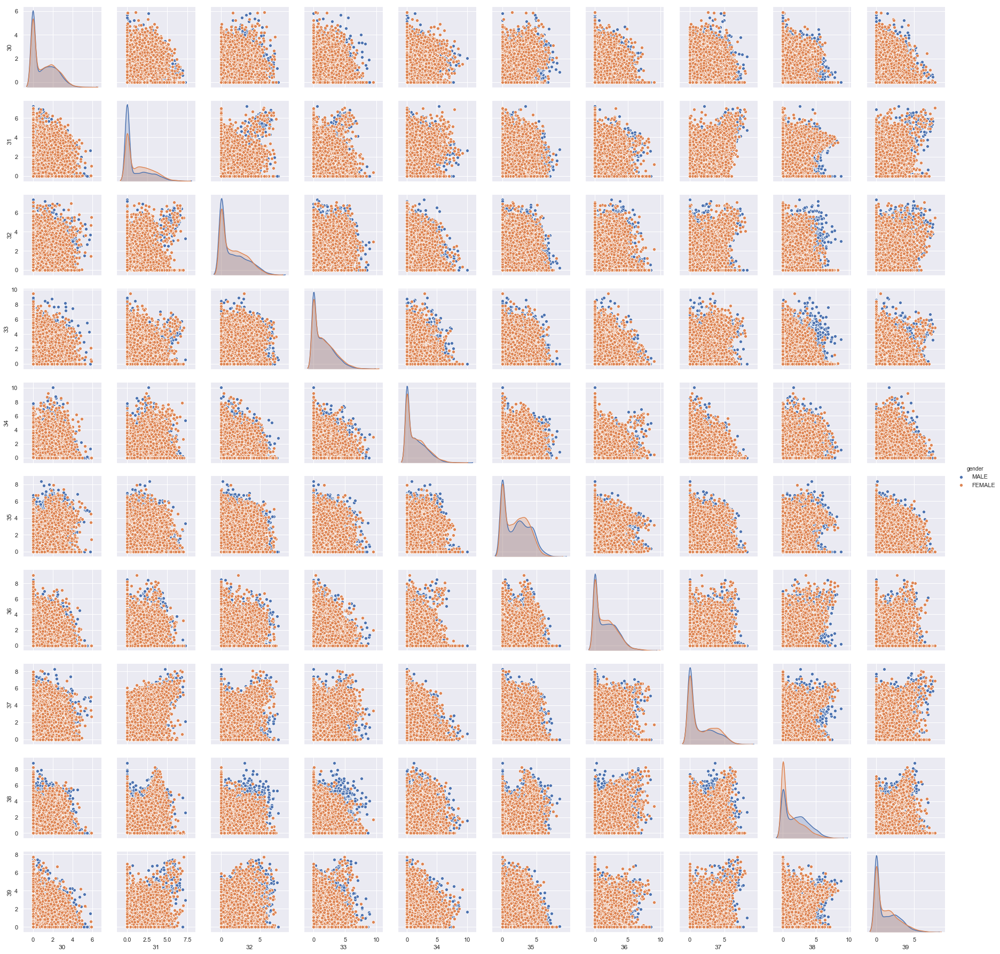

In [45]:
sns.pairplot(encoded_sex_40, hue="gender")

### 40-50

In [46]:
encoded_sex_50 = pd.merge(encoded_hipathia.iloc[:,40:50], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_50

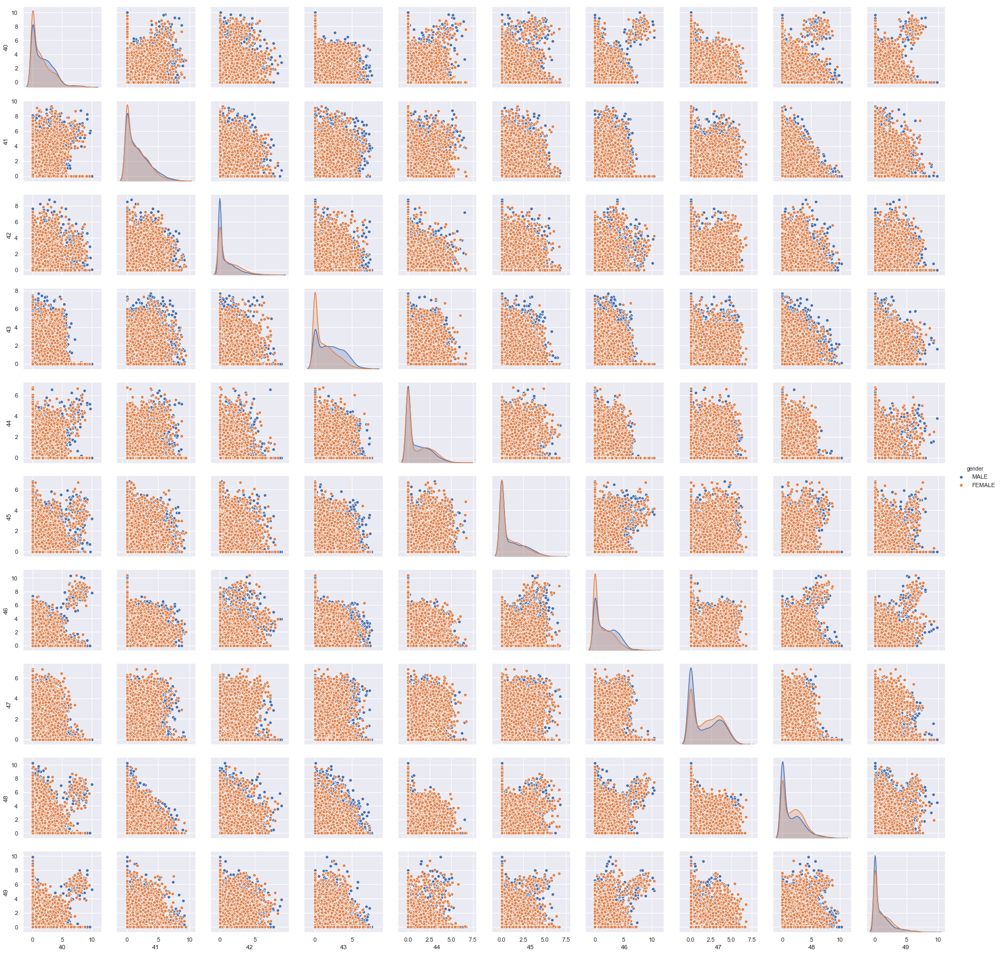

In [47]:
sns.pairplot(encoded_sex_50, hue="gender")

### 50-60

In [48]:
encoded_sex_60 = pd.merge(encoded_hipathia.iloc[:,50:60], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_60

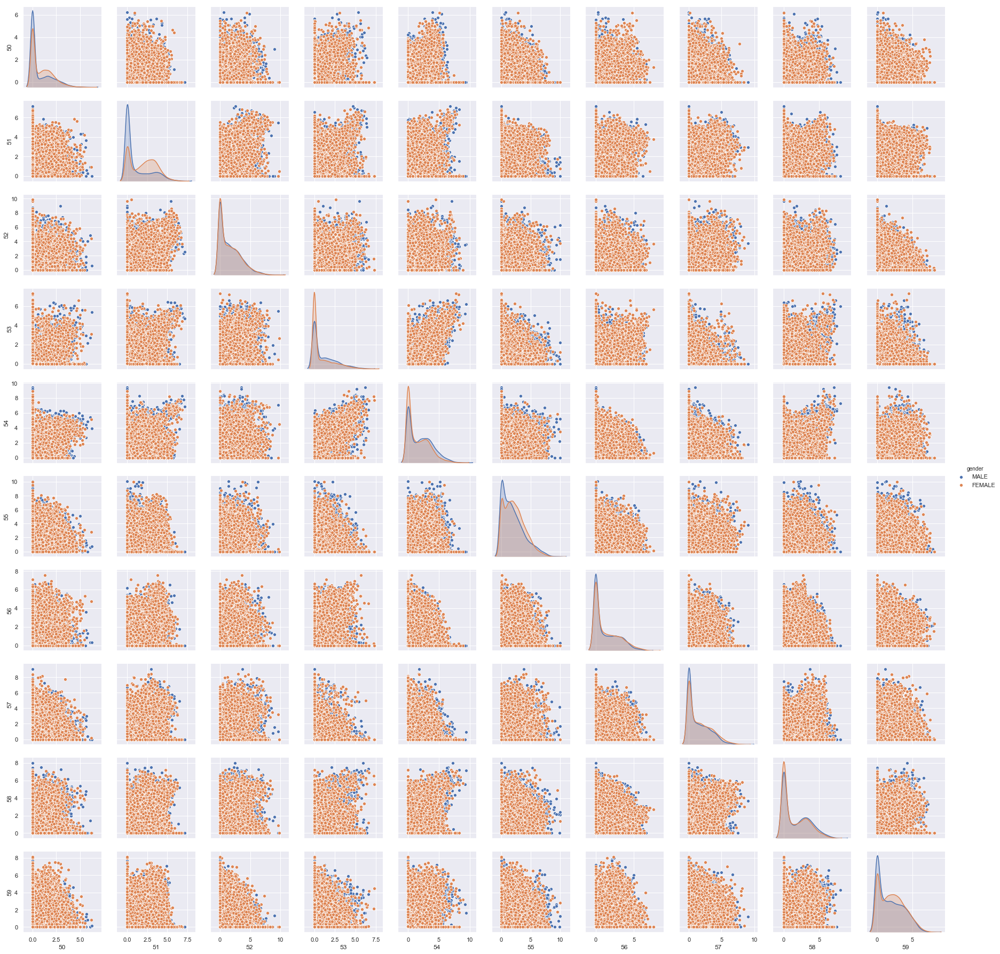

In [49]:
sns.pairplot(encoded_sex_60, hue="gender")

### 60-70

In [50]:
encoded_sex_70 = pd.merge(encoded_hipathia.iloc[:,60:70], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_70

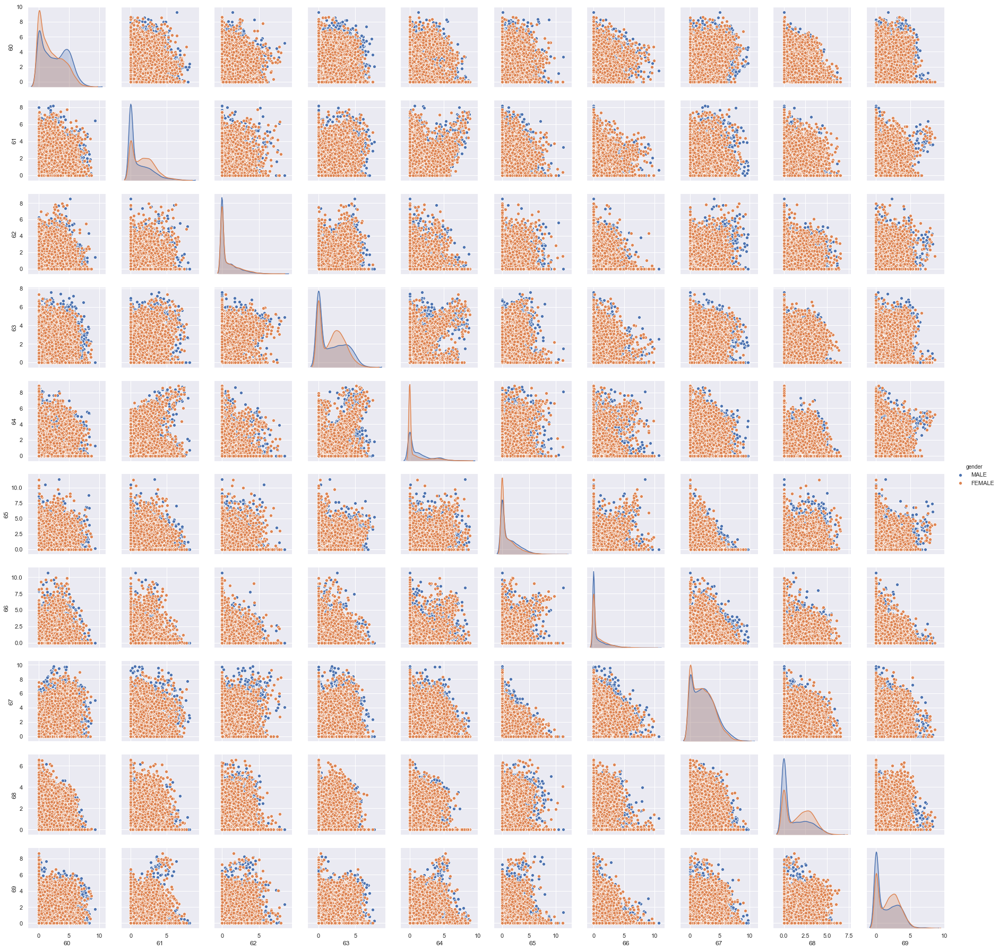

In [51]:
sns.pairplot(encoded_sex_70, hue="gender")

### 70-80

In [52]:
encoded_sex_80 = pd.merge(encoded_hipathia.iloc[:,70:80], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_80

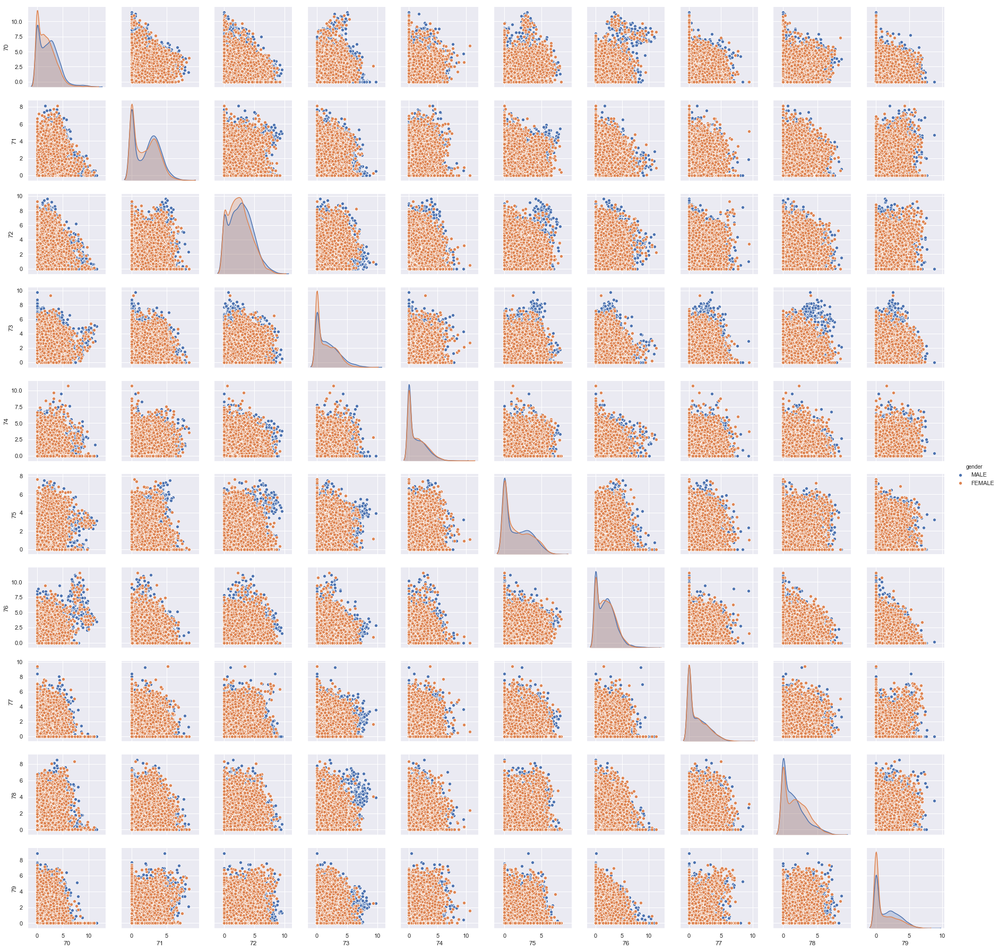

In [53]:
sns.pairplot(encoded_sex_80, hue="gender")

### 80-90

In [54]:
encoded_sex_90 = pd.merge(encoded_hipathia.iloc[:,80:90], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_90

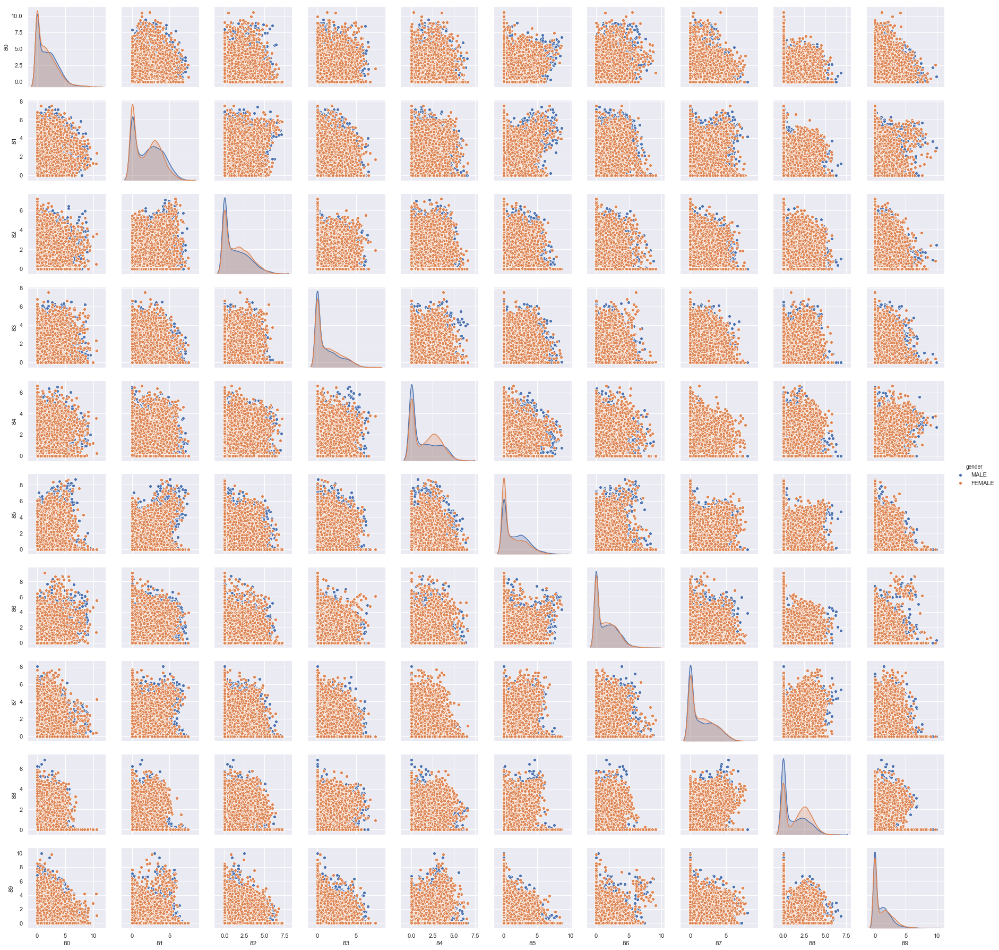

In [55]:
sns.pairplot(encoded_sex_90, hue="gender")

### 90-100

In [56]:
encoded_sex_100 = pd.merge(encoded_hipathia.iloc[:,90:100], whole_hipathia_gender, right_index=True,left_index=True)
##encoded_sex_100

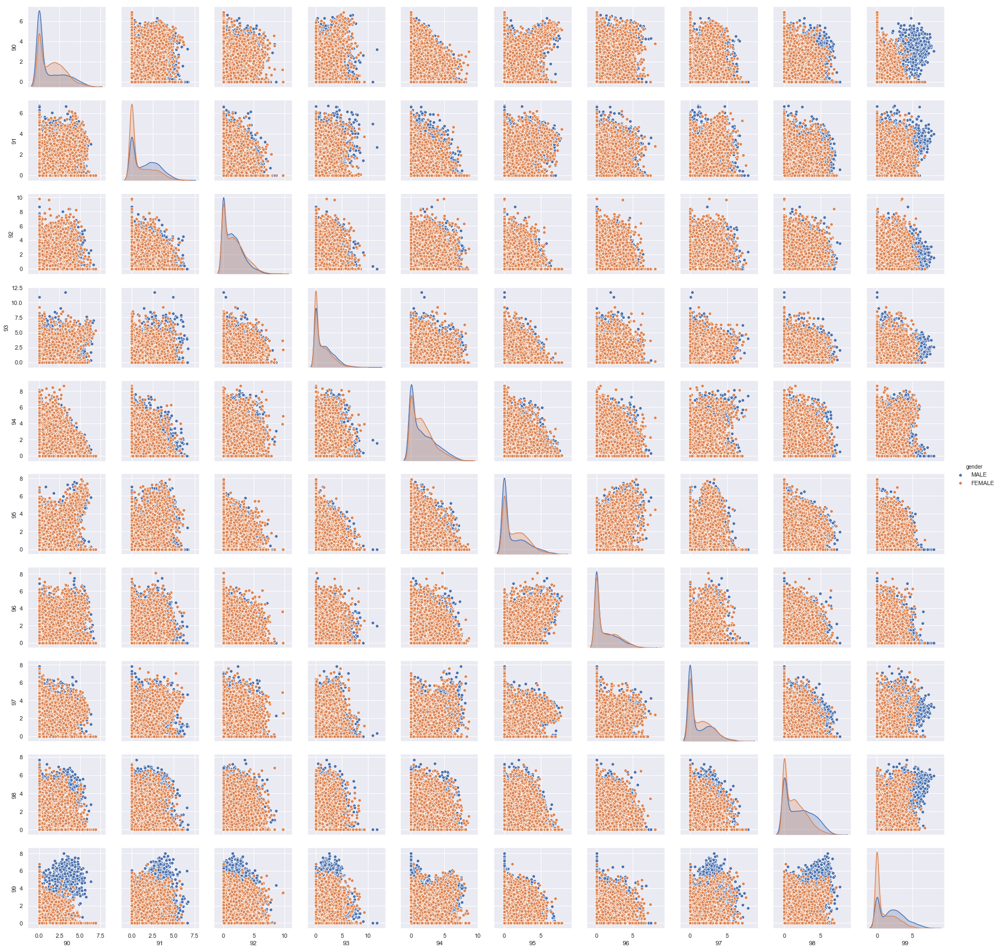

In [57]:
sns.pairplot(encoded_sex_100, hue="gender")

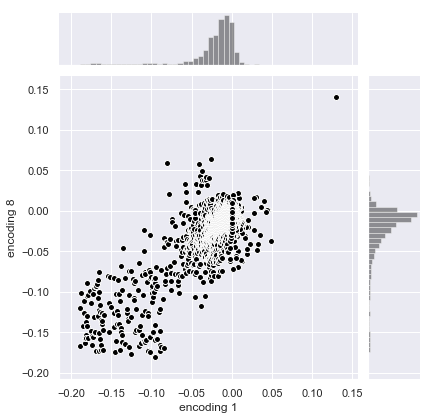

In [58]:
# We previously identified node 82 as robustly separating sex in the data set:
# Visualize the distribution of gene weights here
sex_node_plot = weight_layer_df.loc[[1, 8], :].T
sex_node_plot.columns = ['encoding 1', 'encoding 8']

sex_node_plot = (
    sex_node_plot.reindex(sex_node_plot['encoding 1'].abs()
                          .sort_values(ascending=False).index)
    )

g = sns.jointplot(x='encoding 1', y='encoding 8',
                  data=sex_node_plot, color='black',
                  edgecolor="w", stat_func=None);

# Save Figure
sex_node_plot_file = os.path.join('figures', 'sex_node_gene_scatter.pdf')
g.savefig(sex_node_plot_file)

In [59]:
weight_layer_df.loc[[1, 8], :].T

encodings,1,8
P-hsa03320-37,-0.001568,-0.059229
P-hsa03320-61,-0.019510,-0.047180
P-hsa03320-46,-0.044502,-0.043932
P-hsa03320-57,-0.056797,-0.076901
P-hsa03320-64,-0.054299,-0.060143
P-hsa03320-47,-0.003687,-0.009905
P-hsa03320-65,-0.015276,-0.001272
P-hsa03320-55,-0.021915,-0.008068
P-hsa03320-56,-0.007974,-0.002355
P-hsa03320-33,-0.062860,-0.048934


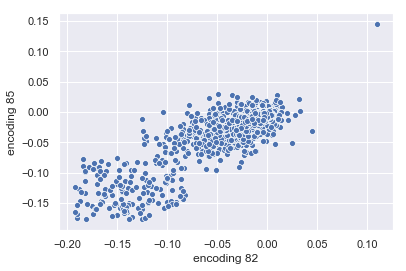

In [60]:
sex_node_plot = weight_layer_df.loc[[82, 85], :].T
sex_node_plot.columns = ['encoding 82', 'encoding 85']
cmap = sns.cubehelix_palette(rot=-.2, as_cmap=True)
ax = sns.scatterplot(x="encoding 82", y="encoding 85"
                     ,palette=cmap, sizes=(10, 200),
                     data=sex_node_plot)

## Pasos
-Tests estadísticos (Visualizaciones)...
-Errores cancer,subtipos de cancer...(Cuidado Na)


-Clasificadores.
-*SHAP.